In [2]:
from keras.datasets import mnist
from direpack import dicomo, ppdire
import numpy as np
from sklearn.neighbors import KernelDensity
from sklearn.model_selection import GridSearchCV
import matplotlib.pyplot as plt

In [3]:
(x_train, y_train), (x_test, y_test) = mnist.load_data()
x1_train = x_train.reshape(60000, 784)
x1_test = x_test.reshape(10000, 784)

In [4]:
# test PCA efficiency of different data dimensions
x = x1_train[:, :]

## Dimension reduction: 2D

In [9]:
pppca_2d = ppdire(projection_index = dicomo, pi_arguments = {'mode' : 'var'}, n_components=2, optimizer='SLSQP')
pppca_2d.fit(x)
res_2d = np.dot(x, pppca_2d.x_loadings_)

# 使用网格搜索交叉验证来优化带宽
params_2d = {'bandwidth': np.logspace(1, 3, 20)}
grid_2d = GridSearchCV(KernelDensity(), params_2d)
grid_2d.fit(res_2d)
print("best bandwidth 2d: {0}".format(grid_2d.best_estimator_.bandwidth))

# 使用最佳估计器来计算核密度估计
kde_2d = grid_2d.best_estimator_

best bandwidth 2d: 42.81332398719393


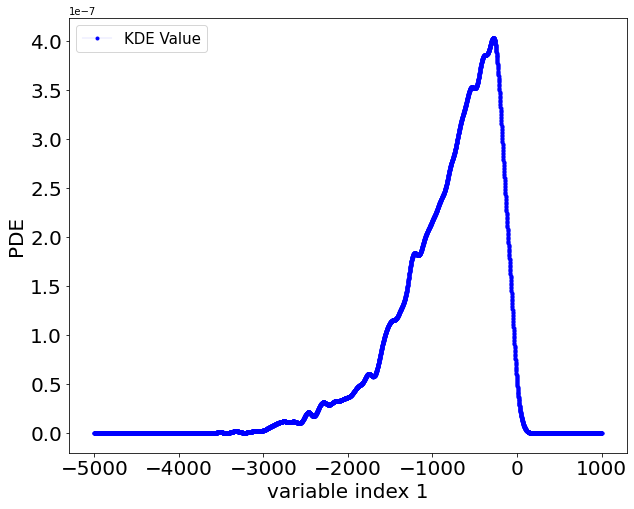

In [10]:
xplot_1d = np.linspace(-5000, 1000, 6000).reshape(-1,1)
xplot_2d_1 = np.hstack((xplot_1d, np.zeros(6000).reshape(-1,1)))
dens_2d_1 = kde_2d.score_samples(xplot_2d_1)  # 返回的是点对应概率密度的log值，需要使用exp求指数还原
plt.figure(figsize = (10, 8))  # 设置画布大小
plt.plot(xplot_1d, np.exp(dens_2d_1), marker='.', linewidth=0.1, c="b", label='KDE Value')
plt.tick_params(labelsize = 20)  # 设置坐标刻度值的大小      
font = {'size': 20}  # 设置横纵坐标的名称以及对应字体格式、大小
plt.xlabel('variable index 1', font)
plt.ylabel('PDE', font)
plt.legend(fontsize = 15)  # 显示图例,设置图例字体大小
plt.show()

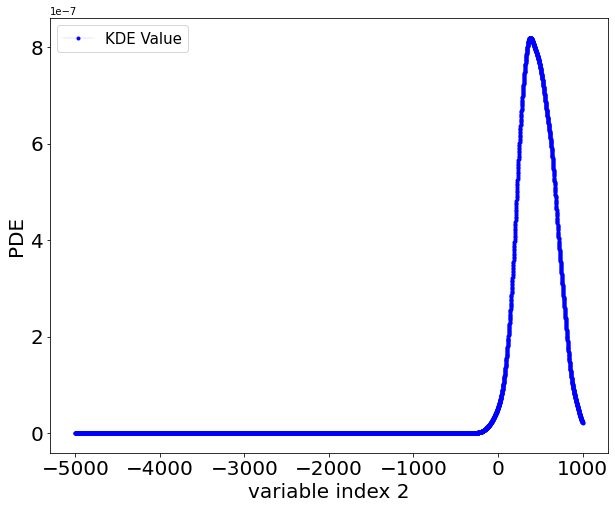

In [11]:
xplot_2d_2 = np.hstack((np.zeros(6000).reshape(-1,1), xplot_1d))
dens_2d_2 = kde_2d.score_samples(xplot_2d_2)  # 返回的是点对应概率密度的log值，需要使用exp求指数还原
plt.figure(figsize = (10, 8))  # 设置画布大小
plt.plot(xplot_1d, np.exp(dens_2d_2), marker='.', linewidth=0.1, c="b", label='KDE Value')
plt.tick_params(labelsize = 20)  # 设置坐标刻度值的大小      
font = {'size': 20}  # 设置横纵坐标的名称以及对应字体格式、大小
plt.xlabel('variable index 2', font)
plt.ylabel('PDE', font)
plt.legend(fontsize = 15)  # 显示图例,设置图例字体大小
plt.show()

#### 2D Visualization

In [5]:
pppca_2d = ppdire(projection_index = dicomo, pi_arguments = {'mode' : 'var'}, n_components=2, optimizer='SLSQP')
pppca_2d.fit(x)
res_2d = np.dot(x, pppca_2d.x_loadings_)

In [6]:
kde_2d = KernelDensity(bandwidth=42.81332398719393).fit(res_2d)

In [7]:
xplot = np.linspace(-4000, 1000, 500)
yplot = np.linspace(-1000, 4000, 500)
xplot = np.tile(xplot, 500)[:, np.newaxis]
yplot = np.repeat(yplot, 500)[:, np.newaxis]
xyplot = np.hstack((xplot, yplot))
zplot = kde_2d.score_samples(xyplot)

Text(0.5, 1.0, 'KDE Density')

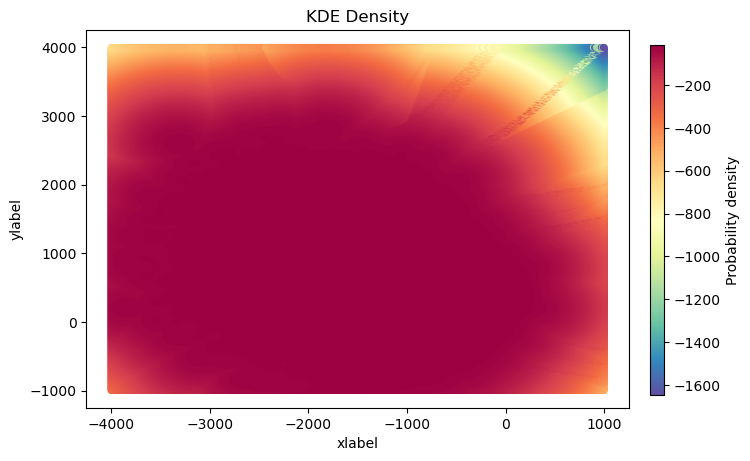

In [8]:
fig, ax = plt.subplots(figsize=(7,5),dpi=100)
scatter = ax.scatter(xplot, yplot, marker='o', c=zplot, edgecolors='none', s=25, label='label', cmap='Spectral_r')
cbar_ax = plt.gcf().add_axes([0.93, 0.15, 0.02, 0.7]) #[left, bottom, width, height]
cbar = fig.colorbar(scatter, cax=cbar_ax, label='Probability density')
ax.set_xlabel('xlabel')
ax.set_ylabel('ylabel')
ax.set_title('KDE Density')